#### Hello!!! Gonna try to do a different property tax study about the city of providence. Lets see what happens!!

##### Property Tax data from https://data.providenceri.gov/dataset/2023-Property-Tax-Roll/fd8d-n74v/about_data

##### Geojson parcel data from https://data.providenceri.gov/Neighborhoods/Providence-Parcel-Boundaries-2017/78bu-i8at

Thanks Providence!!

Note that the Tax data is from 2023 but the parcel data is from 2017. Luckily they share the TAX_MAP and propid columns respectively


In [1]:
import pandas as pd
import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import folium
from folium import Figure

pd.set_option('display.max_columns', None) ### This line makes all the columns display, rather than ellipses shorten

parcel_data_frame = gpd.read_file("C:/Users/aaron/Code/Data/Providence Parcel Boundaries 2017.geojson")
tax_data_frame = pd.read_csv("C:/Users/aaron/Code/Data/2023_Property_Tax_Roll_2024Providence.csv")

In [2]:
parcel_data_frame.head()

,ass_land,shape_area,area_ac,owner_add,propid,tax_year,area_sf,parc_add,shape_leng,owner_city,ass_bldg,ownerstate,cama_link,lot,plat,owner_ctry,ass_total,unit,ownername,owner_zip,geometry
0,30200,3226.88028994,0.0738292,49 Homer St,059-0291-0000,None,3216,49 Homer St,241.323816984,Providence,68000,RI,590291,291,59,None,100900,None,Juana Cabrera,02905,"MULTIPOLYGON (((-71.40579 41.78827, -71.40592 ..."
1,30200,3504.26967041,0.0738292,1476 Broad St,059-0202-0000,None,3216,13 Payton St,250.066978218,Providence,98200,RI,590202,202,59,None,129000,None,Casablanca Home Inspectrions RI LLC,02905,"MULTIPOLYGON (((-71.40421 41.78837, -71.40415 ..."
2,30200,3307.40362308,0.0738292,64 Carr St,059-0388-0000,None,3216,64 Carr St,242.868704256,Providence,115100,RI,590388,388,59,None,147600,None,Sharon McKenzie,02905,"MULTIPOLYGON (((-71.40645 41.78828, -71.40658 ..."
3,30200,3182.73277998,0.07293388,87 Carr St,059-0167-0000,None,3177,87 Carr St,245.120061304,Providence,103400,RI,590167,167,59,None,134900,None,Ashley Pimentel,02905,"MULTIPOLYGON (((-71.40743 41.78828, -71.40756 ..."
4,27400,4042.63512977,0.09148301,PO Box 40573 AVE,059-0032-0000,None,3985,1413 Broad St,278.198271506,PROVIDENCE,69300,RI,590032,32,59,None,96700,None,None,02940,"MULTIPOLYGON (((-71.40382 41.78838, -71.40415 ..."


In [3]:
tax_data_frame.head()

,P_ID,TAX_MAP,plat,lot,unit,CLASS,SHORT_DESC,LEVY_CODE_1,SHORT_DESC 1,CIVIC,STREET,SUFFIX,FORMATED_ADDRESS,CITY,ZIP_POSTAL,FIRST_NAME,LAST_NAME,COMPANY,OWNER_FORMATED_ADDRESS,OWNER_CIVIC,OWNER_STREET,OWNER_SUFFIX,OWNER_UNIT,OWNER_CITY,OWNER_STATE,OWNER_ZIP_POSTAL,TOTAL_ASSMT,TOTAL_EXEMPT,TOTAL_TAXES,Geolocation,Owner_Geolocation
0,4218.0,014-0508-0000,14.0,508.0,0000,83.0,44-3-9 Stb,TSA,TSA,225.0,Waterman,St,225 Waterman St,Providence,02906,Fili,Investment LLC,NaN,441 Angell St,441,Angell,St,NaN,Providence,RI,02906,4852000.0,2636499.72,77764.08,POINT (-71.388885012 41.828341001),POINT (-71.389923027 41.829631017)
1,6072.0,019-0109-0000,19.0,109.0,0000,83.0,44-3-9 Stb,TSA,TSA,10.0,Memorial,Blvd,10 Memorial Blvd,Providence,02903,NaN,NaN,TFG Providence Center Property LLC,10 Memorial Blvd,10,Memorial,Blvd,NaN,Providence,RI,02903,59469900.0,22432862.96,1300000.00,POINT (-71.414920963 41.826534994),POINT (-71.414920963 41.826534994)
2,6084.0,019-0120-0000,19.0,120.0,0000,83.0,44-3-9 Stb,TSA,TSA,5.0,Exchange,St,5 Exchange St,Providence,02903,NaN,NaN,Exchange St Hotel LLC,c/o First Bristol Corp,PO,Box 2516,NaN,NaN,Fall River,MA,02722,10345300.0,6776764.00,125255.64,POINT (-71.411456974 41.826617011),POINT (-71.15533 41.70207)
3,6113.0,020-0008-0000,20.0,8.0,0000,83.0,44-3-9 Stb,TSA,TSA,59.0,Westminster,St,59 Westminster St,Providence,02903,30 Kennedy,Partners LLC,NaN,"100 Westminster St., Ste 1700",100,"Westminster St., Ste 1700",NaN,NaN,Providence,RI,02903,4522300.0,1062415.10,121441.96,POINT (-71.409883011 41.824979505),POINT (-71.410668991 41.824813016)
4,6115.0,020-0014-0000,20.0,14.0,0000,83.0,44-3-9 Stb,TSA,TSA,55.0,Kennedy,Plz,55 Kennedy Plz,Providence,02903,NaN,NaN,High Rock Westminster Street,275 Grove St Unit 2-400,275,Grove,St,2-400,NEWTON,MA,02466,14093500.0,0.00,498910.00,POINT (-71.411709116 41.825331438),POINT (-71.254170226 42.339459775)


In [4]:
#change all state abbreviations and owner names to upper case.
parcel_data_frame['ownerstate'] = parcel_data_frame['ownerstate'].str.upper()
parcel_data_frame['ownername'] = parcel_data_frame['ownername'].str.upper()

In [5]:
parcel_data_frame['ass_land'].value_counts()

0          4323
46600       903
30200       592
26300       536
32900       496
           ... 
272600        1
245800        1
352500        1
1058200       1
613400        1
Name: ass_land, Length: 3992, dtype: int64

In [6]:
parcel_data_frame.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 44190 entries, 0 to 44189
Data columns (total 21 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   ass_land    44190 non-null  object  
 1   shape_area  44190 non-null  object  
 2   area_ac     44190 non-null  object  
 3   owner_add   40304 non-null  object  
 4   propid      44005 non-null  object  
 5   tax_year    0 non-null      object  
 6   area_sf     44190 non-null  object  
 7   parc_add    44003 non-null  object  
 8   shape_leng  44190 non-null  object  
 9   owner_city  43696 non-null  object  
 10  ass_bldg    44190 non-null  object  
 11  ownerstate  43692 non-null  object  
 12  cama_link   44005 non-null  object  
 13  lot         44005 non-null  object  
 14  plat        44005 non-null  object  
 15  owner_ctry  789 non-null    object  
 16  ass_total   44190 non-null  object  
 17  unit        4728 non-null   object  
 18  ownername   42743 non-null  object  
 

In [7]:
tax_data_frame.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 44304 entries, 0 to 44303
Data columns (total 31 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   P_ID                    44303 non-null  float64
 1   TAX_MAP                 44303 non-null  object 
 2   plat                    44303 non-null  float64
 3   lot                     44303 non-null  float64
 4   unit                    44303 non-null  object 
 5   CLASS                   44303 non-null  float64
 6   SHORT_DESC              44303 non-null  object 
 7   LEVY_CODE_1             44303 non-null  object 
 8   SHORT_DESC 1            44303 non-null  object 
 9   CIVIC                   44204 non-null  float64
 10  STREET                  44297 non-null  object 
 11  SUFFIX                  42572 non-null  object 
 12  FORMATED_ADDRESS        44301 non-null  object 
 13  CITY                    44089 non-null  object 
 14  ZIP_POSTAL              42638 non-null

<Axes: >

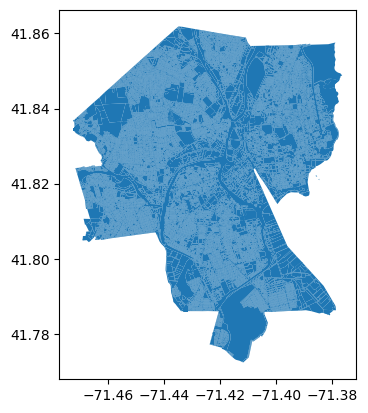

In [8]:
parcel_data_frame.plot()

In [9]:
### Select a row by value
tax_data_frame.loc[tax_data_frame['TAX_MAP'] == '059-0167-0000']

,P_ID,TAX_MAP,plat,lot,unit,CLASS,SHORT_DESC,LEVY_CODE_1,SHORT_DESC 1,CIVIC,STREET,SUFFIX,FORMATED_ADDRESS,CITY,ZIP_POSTAL,FIRST_NAME,LAST_NAME,COMPANY,OWNER_FORMATED_ADDRESS,OWNER_CIVIC,OWNER_STREET,OWNER_SUFFIX,OWNER_UNIT,OWNER_CITY,OWNER_STATE,OWNER_ZIP_POSTAL,TOTAL_ASSMT,TOTAL_EXEMPT,TOTAL_TAXES,Geolocation,Owner_Geolocation
12627,21148.0,059-0167-0000,59.0,167.0,0000,2.0,2 -5 Family,R01,RE Tax,87.0,Carr,St,87 Carr St,Providence,02905,Ashley,Pimentel,NaN,87 Carr St,87,Carr,St,NaN,Providence,RI,02905,347900.0,149597.0,3638.88,POINT (-71.407548995 41.788330992),POINT (-71.407548995 41.788330992)


In [10]:
#### Merge the dfs!

main_frame = pd.merge(left = tax_data_frame, right = parcel_data_frame, left_on = 'TAX_MAP', right_on = 'propid', how = 'inner')

In [11]:
main_frame.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 43557 entries, 0 to 43556
Data columns (total 52 columns):
 #   Column                  Non-Null Count  Dtype   
---  ------                  --------------  -----   
 0   P_ID                    43372 non-null  float64 
 1   TAX_MAP                 43372 non-null  object  
 2   plat_x                  43372 non-null  float64 
 3   lot_x                   43372 non-null  float64 
 4   unit_x                  43372 non-null  object  
 5   CLASS                   43372 non-null  float64 
 6   SHORT_DESC              43372 non-null  object  
 7   LEVY_CODE_1             43372 non-null  object  
 8   SHORT_DESC 1            43372 non-null  object  
 9   CIVIC                   43299 non-null  float64 
 10  STREET                  43368 non-null  object  
 11  SUFFIX                  41680 non-null  object  
 12  FORMATED_ADDRESS        43371 non-null  object  
 13  CITY                    43179 non-null  object  
 14  ZIP_POSTAL            

In [12]:
main_frame.head()

,P_ID,TAX_MAP,plat_x,lot_x,unit_x,CLASS,SHORT_DESC,LEVY_CODE_1,SHORT_DESC 1,CIVIC,STREET,SUFFIX,FORMATED_ADDRESS,CITY,ZIP_POSTAL,FIRST_NAME,LAST_NAME,COMPANY,OWNER_FORMATED_ADDRESS,OWNER_CIVIC,OWNER_STREET,OWNER_SUFFIX,OWNER_UNIT,OWNER_CITY,OWNER_STATE,OWNER_ZIP_POSTAL,TOTAL_ASSMT,TOTAL_EXEMPT,TOTAL_TAXES,Geolocation,Owner_Geolocation,ass_land,shape_area,area_ac,owner_add,propid,tax_year,area_sf,parc_add,shape_leng,owner_city,ass_bldg,ownerstate,cama_link,lot_y,plat_y,owner_ctry,ass_total,unit_y,ownername,owner_zip,geometry
0,4218.0,014-0508-0000,14.0,508.0,0000,83.0,44-3-9 Stb,TSA,TSA,225.0,Waterman,St,225 Waterman St,Providence,02906,Fili,Investment LLC,NaN,441 Angell St,441,Angell,St,NaN,Providence,RI,02906,4852000.0,2636499.72,77764.08,POINT (-71.388885012 41.828341001),POINT (-71.389923027 41.829631017),263500,6853.60981188,0.15668044,197 Taunton Ave,014-0508-0000,None,6825,225 Waterman St,359.504047849,East Providence,116200,RI,140508,508,14,None,392200,None,MANWATER REALTY LLC,02914-4537,"MULTIPOLYGON (((-71.38881 41.82847, -71.38868 ..."
1,6072.0,019-0109-0000,19.0,109.0,0000,83.0,44-3-9 Stb,TSA,TSA,10.0,Memorial,Blvd,10 Memorial Blvd,Providence,02903,NaN,NaN,TFG Providence Center Property LLC,10 Memorial Blvd,10,Memorial,Blvd,NaN,Providence,RI,02903,59469900.0,22432862.96,1300000.00,POINT (-71.414920963 41.826534994),POINT (-71.414920963 41.826534994),5979000,74497.9922485,1.6432966,10 Memorial Blvd,019-0109-0000,None,71582,10 Memorial Blvd,1086.50050782,Providence,48072100,RI,190109,109,19,None,55319800,None,10 MEMORIAL BOULEVARD OWNER LLC,02903,"MULTIPOLYGON (((-71.41512 41.82702, -71.41477 ..."
2,6084.0,019-0120-0000,19.0,120.0,0000,83.0,44-3-9 Stb,TSA,TSA,5.0,Exchange,St,5 Exchange St,Providence,02903,NaN,NaN,Exchange St Hotel LLC,c/o First Bristol Corp,PO,Box 2516,NaN,NaN,Fall River,MA,02722,10345300.0,6776764.00,125255.64,POINT (-71.411456974 41.826617011),POINT (-71.15533 41.70207),1858700,27106.4500955,0.55668044,400 Westminster St,019-0120-0000,None,24249,5 Exchange St,688.918783353,Providence,0,RI,190120,120,19,None,1858700,None,PROVIDENCE REDEVELOPMENT AGENCY,02903-3222,"MULTIPOLYGON (((-71.41155 41.82625, -71.41155 ..."
3,6113.0,020-0008-0000,20.0,8.0,0000,83.0,44-3-9 Stb,TSA,TSA,59.0,Westminster,St,59 Westminster St,Providence,02903,30 Kennedy,Partners LLC,NaN,"100 Westminster St., Ste 1700",100,"Westminster St., Ste 1700",NaN,NaN,Providence,RI,02903,4522300.0,1062415.10,121441.96,POINT (-71.409883011 41.824979505),POINT (-71.410668991 41.824813016),655800,9079.90523559,0.21120294,None,020-0008-0000,None,9200,59 Westminster St,486.77467482,Providence,2117600,RI,200008,8,20,None,2929800,None,30 KENNEDY PARTNERS LLC,02903,"MULTIPOLYGON (((-71.41003 41.82490, -71.41015 ..."
4,6115.0,020-0014-0000,20.0,14.0,0000,83.0,44-3-9 Stb,TSA,TSA,55.0,Kennedy,Plz,55 Kennedy Plz,Providence,02903,NaN,NaN,High Rock Westminster Street,275 Grove St Unit 2-400,275,Grove,St,2-400,NEWTON,MA,02466,14093500.0,0.00,498910.00,POINT (-71.411709116 41.825331438),POINT (-71.254170226 42.339459775),1411100,32236.3097903,0.64187328,275 Grove St,020-0014-0000,None,27960,55 Kennedy Plz,721.892565303,NEWTON,12050900,MA,200014,14,20,None,14159800,None,HIGH ROCK WESTMINSTER STREET,02466,"MULTIPOLYGON (((-71.41105 41.82415, -71.41110 ..."


In [13]:
### adding a new column to the main frame that represents the portion of assesed taxes that end up being paid
main_frame['realized_tax_pct'] = (main_frame['TOTAL_TAXES'] / main_frame['TOTAL_ASSMT']) * 100

## cast the sqft column as a float
main_frame['shape_area'] = pd.to_numeric(main_frame['shape_area'])

In [14]:
main_frame.head()

,P_ID,TAX_MAP,plat_x,lot_x,unit_x,CLASS,SHORT_DESC,LEVY_CODE_1,SHORT_DESC 1,CIVIC,STREET,SUFFIX,FORMATED_ADDRESS,CITY,ZIP_POSTAL,FIRST_NAME,LAST_NAME,COMPANY,OWNER_FORMATED_ADDRESS,OWNER_CIVIC,OWNER_STREET,OWNER_SUFFIX,OWNER_UNIT,OWNER_CITY,OWNER_STATE,OWNER_ZIP_POSTAL,TOTAL_ASSMT,TOTAL_EXEMPT,TOTAL_TAXES,Geolocation,Owner_Geolocation,ass_land,shape_area,area_ac,owner_add,propid,tax_year,area_sf,parc_add,shape_leng,owner_city,ass_bldg,ownerstate,cama_link,lot_y,plat_y,owner_ctry,ass_total,unit_y,ownername,owner_zip,geometry,realized_tax_pct
0,4218.0,014-0508-0000,14.0,508.0,0000,83.0,44-3-9 Stb,TSA,TSA,225.0,Waterman,St,225 Waterman St,Providence,02906,Fili,Investment LLC,NaN,441 Angell St,441,Angell,St,NaN,Providence,RI,02906,4852000.0,2636499.72,77764.08,POINT (-71.388885012 41.828341001),POINT (-71.389923027 41.829631017),263500,6853.609812,0.15668044,197 Taunton Ave,014-0508-0000,None,6825,225 Waterman St,359.504047849,East Providence,116200,RI,140508,508,14,None,392200,None,MANWATER REALTY LLC,02914-4537,"MULTIPOLYGON (((-71.38881 41.82847, -71.38868 ...",1.602722
1,6072.0,019-0109-0000,19.0,109.0,0000,83.0,44-3-9 Stb,TSA,TSA,10.0,Memorial,Blvd,10 Memorial Blvd,Providence,02903,NaN,NaN,TFG Providence Center Property LLC,10 Memorial Blvd,10,Memorial,Blvd,NaN,Providence,RI,02903,59469900.0,22432862.96,1300000.00,POINT (-71.414920963 41.826534994),POINT (-71.414920963 41.826534994),5979000,74497.992248,1.6432966,10 Memorial Blvd,019-0109-0000,None,71582,10 Memorial Blvd,1086.50050782,Providence,48072100,RI,190109,109,19,None,55319800,None,10 MEMORIAL BOULEVARD OWNER LLC,02903,"MULTIPOLYGON (((-71.41512 41.82702, -71.41477 ...",2.185980
2,6084.0,019-0120-0000,19.0,120.0,0000,83.0,44-3-9 Stb,TSA,TSA,5.0,Exchange,St,5 Exchange St,Providence,02903,NaN,NaN,Exchange St Hotel LLC,c/o First Bristol Corp,PO,Box 2516,NaN,NaN,Fall River,MA,02722,10345300.0,6776764.00,125255.64,POINT (-71.411456974 41.826617011),POINT (-71.15533 41.70207),1858700,27106.450096,0.55668044,400 Westminster St,019-0120-0000,None,24249,5 Exchange St,688.918783353,Providence,0,RI,190120,120,19,None,1858700,None,PROVIDENCE REDEVELOPMENT AGENCY,02903-3222,"MULTIPOLYGON (((-71.41155 41.82625, -71.41155 ...",1.210749
3,6113.0,020-0008-0000,20.0,8.0,0000,83.0,44-3-9 Stb,TSA,TSA,59.0,Westminster,St,59 Westminster St,Providence,02903,30 Kennedy,Partners LLC,NaN,"100 Westminster St., Ste 1700",100,"Westminster St., Ste 1700",NaN,NaN,Providence,RI,02903,4522300.0,1062415.10,121441.96,POINT (-71.409883011 41.824979505),POINT (-71.410668991 41.824813016),655800,9079.905236,0.21120294,None,020-0008-0000,None,9200,59 Westminster St,486.77467482,Providence,2117600,RI,200008,8,20,None,2929800,None,30 KENNEDY PARTNERS LLC,02903,"MULTIPOLYGON (((-71.41003 41.82490, -71.41015 ...",2.685403
4,6115.0,020-0014-0000,20.0,14.0,0000,83.0,44-3-9 Stb,TSA,TSA,55.0,Kennedy,Plz,55 Kennedy Plz,Providence,02903,NaN,NaN,High Rock Westminster Street,275 Grove St Unit 2-400,275,Grove,St,2-400,NEWTON,MA,02466,14093500.0,0.00,498910.00,POINT (-71.411709116 41.825331438),POINT (-71.254170226 42.339459775),1411100,32236.309790,0.64187328,275 Grove St,020-0014-0000,None,27960,55 Kennedy Plz,721.892565303,NEWTON,12050900,MA,200014,14,20,None,14159800,None,HIGH ROCK WESTMINSTER STREET,02466,"MULTIPOLYGON (((-71.41105 41.82415, -71.41110 ...",3.540001


In [15]:
homes_owned = main_frame['ownername'].value_counts()

multi_homes_owned = homes_owned[homes_owned > 30]

multi_homes_owned

ATHENA PROVIDENCE PLACE                  361
CITY OF PROVIDENCE                       295
BROWN UNIVERSITY                         172
HOUSING AUTHORITY                        124
STATE OF RHODE ISLAND                    120
CITY PROVIDENCE                           92
RI HOSPITAL                               85
EPN HOUSING PARTNERS                      69
PETER MARINUCCI                           62
PROVIDENCE PUBLIC BUILDINGS AUTHORITY     53
PROVIDENCE COLLEGE                        51
WALTER BRONHARD                           50
43 EATON LLC                              45
MIRIAM HOSPITAL                           39
CALART ASSOCIATES LLC                     38
NARRAGANSETT ELECTRIC COMPANY             35
SOUTHSIDE COMMUNITY LAND TRUST            34
MARSOCCI PROPERTIES LLC                   33
JOHNSON AND WALES UNIVERSITY              32
Name: ownername, dtype: int64

In [16]:
### Creates a new column from property owned count
main_frame['property_owned_counts'] = main_frame['ownername'].map(main_frame['ownername'].value_counts())


In [17]:
main_frame['TOTAL_TAXES'].sum()

324673529.76000005

In [18]:
## create tax only frame
tax_mask = main_frame['TOTAL_TAXES'].notnull()

tax_only_frame = main_frame[tax_mask]

#main_frame['TOTAL_TAXES'].notnull()

In [19]:
tax_only_frame['income_per_sqft'] = tax_only_frame['TOTAL_TAXES'] / tax_only_frame['shape_area']
main_frame['assesed_income_per_sqft'] = main_frame['TOTAL_ASSMT'] / main_frame['shape_area']

C:\Users\aaron\AppData\Local\Temp\ipykernel_27828\3045190819.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tax_only_frame['income_per_sqft'] = tax_only_frame['TOTAL_TAXES'] / tax_only_frame['shape_area']


In [20]:
tax_only_frame.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 40882 entries, 0 to 43371
Data columns (total 55 columns):
 #   Column                  Non-Null Count  Dtype   
---  ------                  --------------  -----   
 0   P_ID                    40882 non-null  float64 
 1   TAX_MAP                 40882 non-null  object  
 2   plat_x                  40882 non-null  float64 
 3   lot_x                   40882 non-null  float64 
 4   unit_x                  40882 non-null  object  
 5   CLASS                   40882 non-null  float64 
 6   SHORT_DESC              40882 non-null  object  
 7   LEVY_CODE_1             40882 non-null  object  
 8   SHORT_DESC 1            40882 non-null  object  
 9   CIVIC                   40830 non-null  float64 
 10  STREET                  40880 non-null  object  
 11  SUFFIX                  39378 non-null  object  
 12  FORMATED_ADDRESS        40882 non-null  object  
 13  CITY                    40729 non-null  object  
 14  ZIP_POSTAL            

In [21]:
#### Cast the tax frame to a GeoDataframe

tax_geo_frame = gpd.GeoDataFrame(tax_only_frame, geometry='geometry')

main_geo_frame = gpd.GeoDataFrame(main_frame, geometry='geometry')

In [22]:
tax_geo_frame.loc[tax_geo_frame['shape_area'] == 0]

,P_ID,TAX_MAP,plat_x,lot_x,unit_x,CLASS,SHORT_DESC,LEVY_CODE_1,SHORT_DESC 1,CIVIC,STREET,SUFFIX,FORMATED_ADDRESS,CITY,ZIP_POSTAL,FIRST_NAME,LAST_NAME,COMPANY,OWNER_FORMATED_ADDRESS,OWNER_CIVIC,OWNER_STREET,OWNER_SUFFIX,OWNER_UNIT,OWNER_CITY,OWNER_STATE,OWNER_ZIP_POSTAL,TOTAL_ASSMT,TOTAL_EXEMPT,TOTAL_TAXES,Geolocation,Owner_Geolocation,ass_land,shape_area,area_ac,owner_add,propid,tax_year,area_sf,parc_add,shape_leng,owner_city,ass_bldg,ownerstate,cama_link,lot_y,plat_y,owner_ctry,ass_total,unit_y,ownername,owner_zip,geometry,realized_tax_pct,property_owned_counts,income_per_sqft


In [23]:
##tax_geo_frame.loc[tax_geo_frame['ownerstate'] == 'Ri'] = 'RI' ##this worked>>

In [24]:
tax_geo_frame.ownerstate.value_counts()

RI    37731
MA     1564
NY      225
FL      154
CA      149
TX      106
CT       87
WA       76
PA       51
NJ       49
NH       45
VA       44
AZ       30
GA       29
OH       28
NC       27
MD       24
SC       23
IL       21
DC       18
OK       17
UT       14
ME       11
NV       10
MO       10
CO        9
DE        8
KY        8
MN        7
NE        5
TN        4
AL        3
NM        3
MI        3
IN        2
IA        2
ND        2
OR        2
KS        2
AK        1
WI        1
SD        1
WV        1
LA        1
AR        1
Name: ownerstate, dtype: int64

In [25]:
tax_by_state = tax_geo_frame.groupby('ownerstate').agg({'TOTAL_TAXES':'mean', 'TOTAL_TAXES':'count'}).reset_index()

tax_by_state = tax_by_state.sort_values(by = 'TOTAL_TAXES', ascending = False)

tax_by_state

,ownerstate,TOTAL_TAXES
35,RI,37731
17,MA,1564
30,NY,225
9,FL,154
4,CA,149
39,TX,106
6,CT,87
42,WA,76
34,PA,51
27,NJ,49


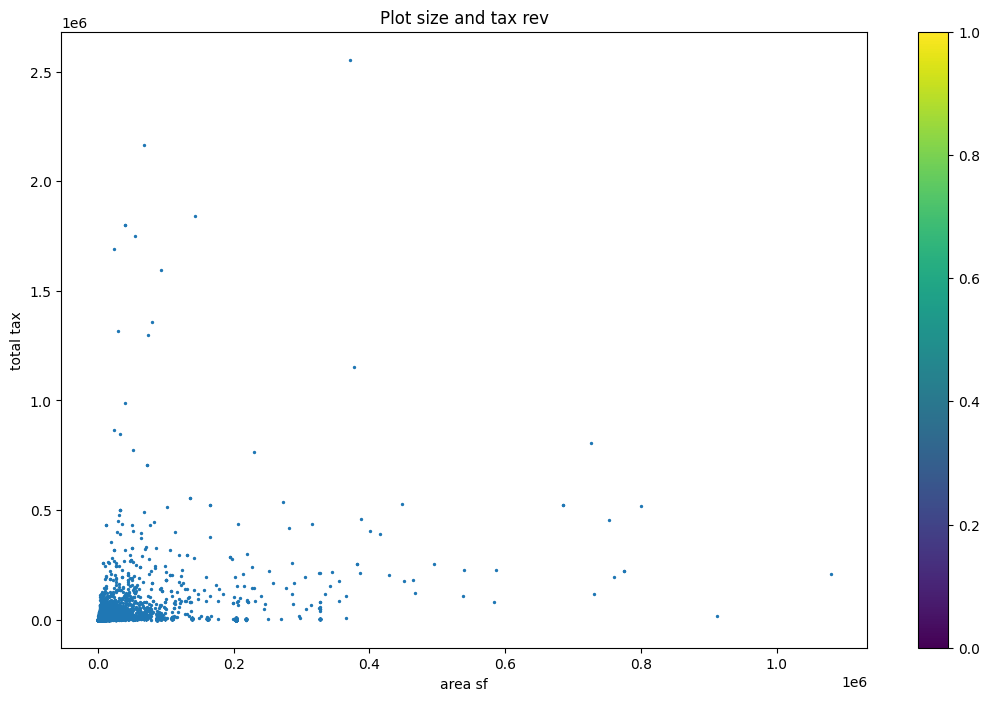

In [26]:
#tax_geo_frame.plot(x = 'area_sf', y = 'TOTAL_TAXES', kind = 'scatter')


x_axis = tax_geo_frame['shape_area']
y_axis = tax_geo_frame['TOTAL_TAXES']
#color = data_frame['HU_OCC20']

fig, ax = plt.subplots(figsize  = (13, 8))

#plt.scatter(x_axis, y_axis, c = color, s = 2, cmap = 'seismic', marker='h')
plt.scatter(x_axis, y_axis, s = 2)
plt.title('Plot size and tax rev')
#plt.rcParams["figure.figsize"] = (10,5.5)
#plt.legend(loc = "lower left")
plt.xlabel('area sf')
plt.ylabel('total tax')
plt.colorbar()
plt.show()

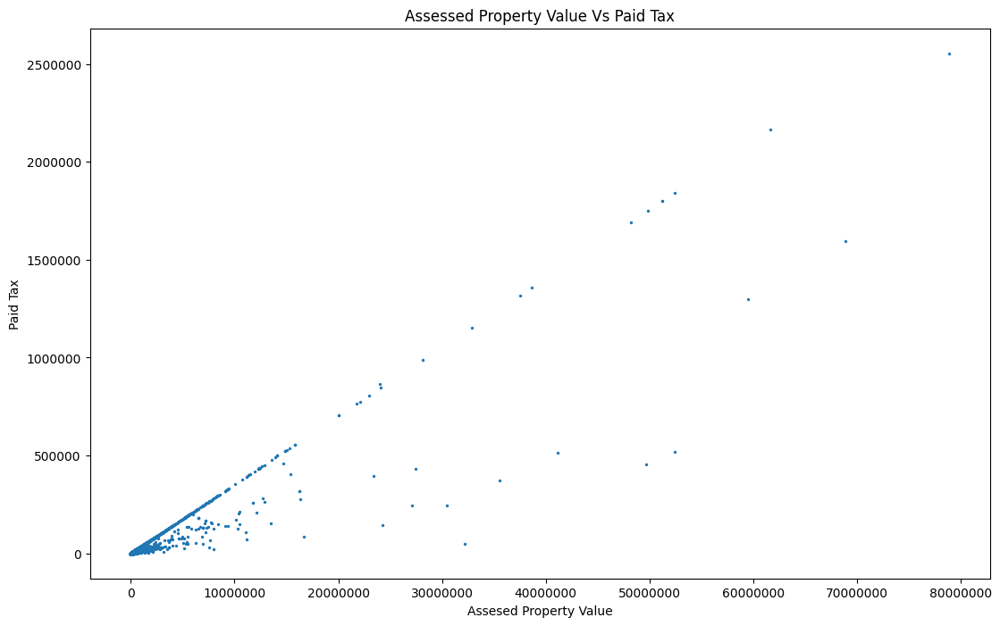

In [42]:
x_axis = main_frame['TOTAL_ASSMT']
y_axis = main_frame['TOTAL_TAXES']
#color = data_frame['HU_OCC20']

fig, ax = plt.subplots(figsize  = (13, 8))


#plt.scatter(x_axis, y_axis, c = color, s = 2, cmap = 'seismic', marker='h')
plt.scatter(x_axis, y_axis, s = 2)
plt.title('Assessed Property Value Vs Paid Tax')
#plt.legend(loc = "lower left")
plt.xlabel('Assesed Property Value')
plt.ylabel('Paid Tax')
#plt.colorbar()
plt.ticklabel_format(style='plain')
plt.show()


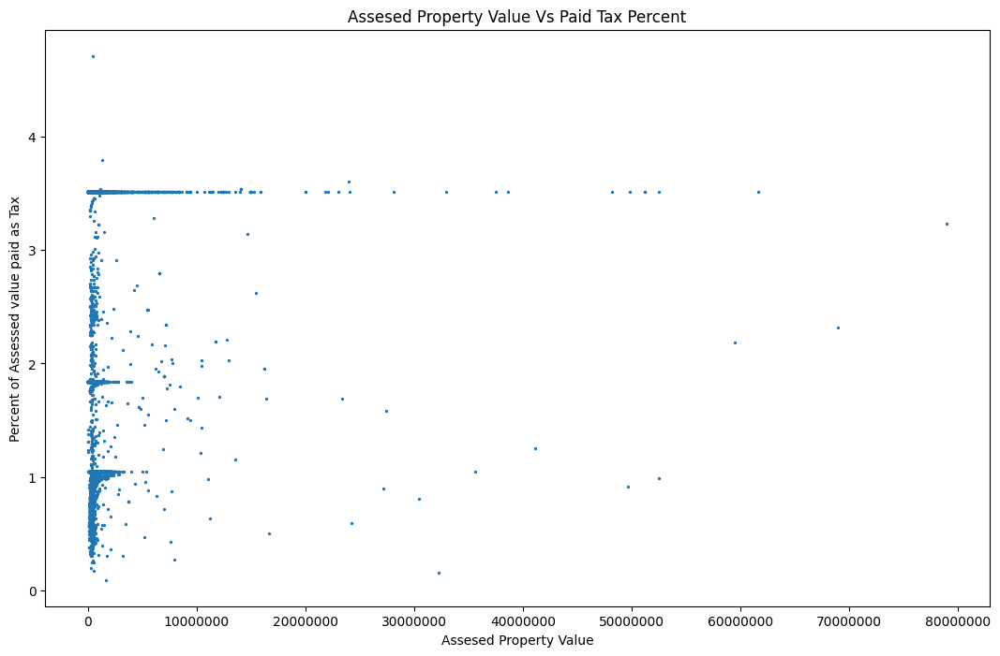

In [43]:
x_axis = main_frame['TOTAL_ASSMT']
y_axis = main_frame['realized_tax_pct']
#color = data_frame['HU_OCC20']

fig, ax = plt.subplots(figsize  = (13, 8))


#plt.scatter(x_axis, y_axis, c = color, s = 2, cmap = 'seismic', marker='h')
plt.scatter(x_axis, y_axis, s = 2)
plt.title('Assesed Property Value Vs Paid Tax Percent')
#plt.legend(loc = "lower left")
plt.xlabel('Assesed Property Value')
plt.ylabel('Percent of Assessed value paid as Tax')
#plt.colorbar()
plt.ticklabel_format(style='plain')
plt.show()

Text(0.5, 1.0, 'Realized Tax percentage')

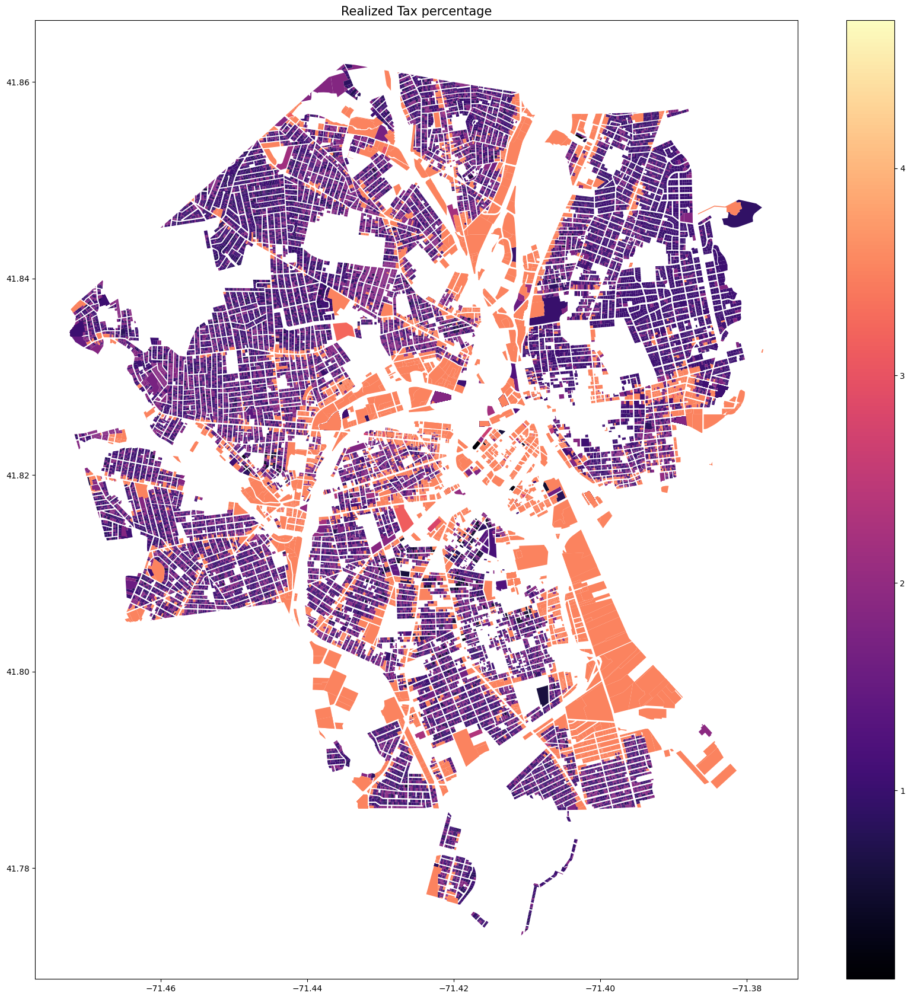

In [29]:
fig, ax = plt.subplots(figsize  = (21, 21))

main_geo_frame.plot(column = 'realized_tax_pct',
                    cmap = 'magma',
                    legend = True,
                    #norm=mpl.colors.LogNorm(vmin = 0.01, vmax = 100),
                    ax = ax)


ax.ticklabel_format(useOffset=False)

ax.set_title("Realized Tax percentage", fontsize=15)

Text(0.5, 1.0, 'Property Tax paid by SQFT, Log scale')

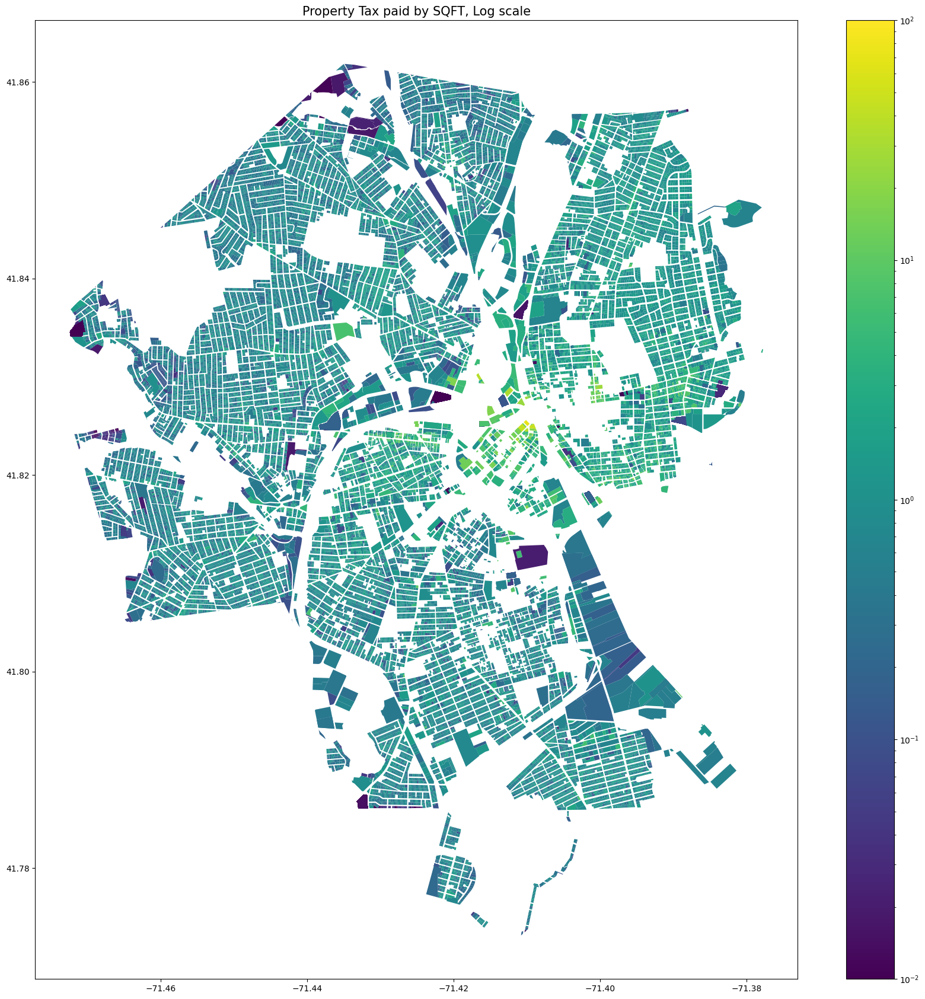

In [30]:
## plotting a 
fig, ax = plt.subplots(figsize  = (21, 21))

tax_geo_frame.plot(column = 'income_per_sqft',
                    #cmap = 'RdGy',
                    legend = True,
                    norm=mpl.colors.LogNorm(vmin = 0.01, vmax = 100),
                    ax = ax)


ax.ticklabel_format(useOffset=False)

ax.set_title("Property Tax paid by SQFT, Log scale", fontsize=15)

Text(0.5, 1.0, 'Assesed Property Value by SQFT, Log scale')

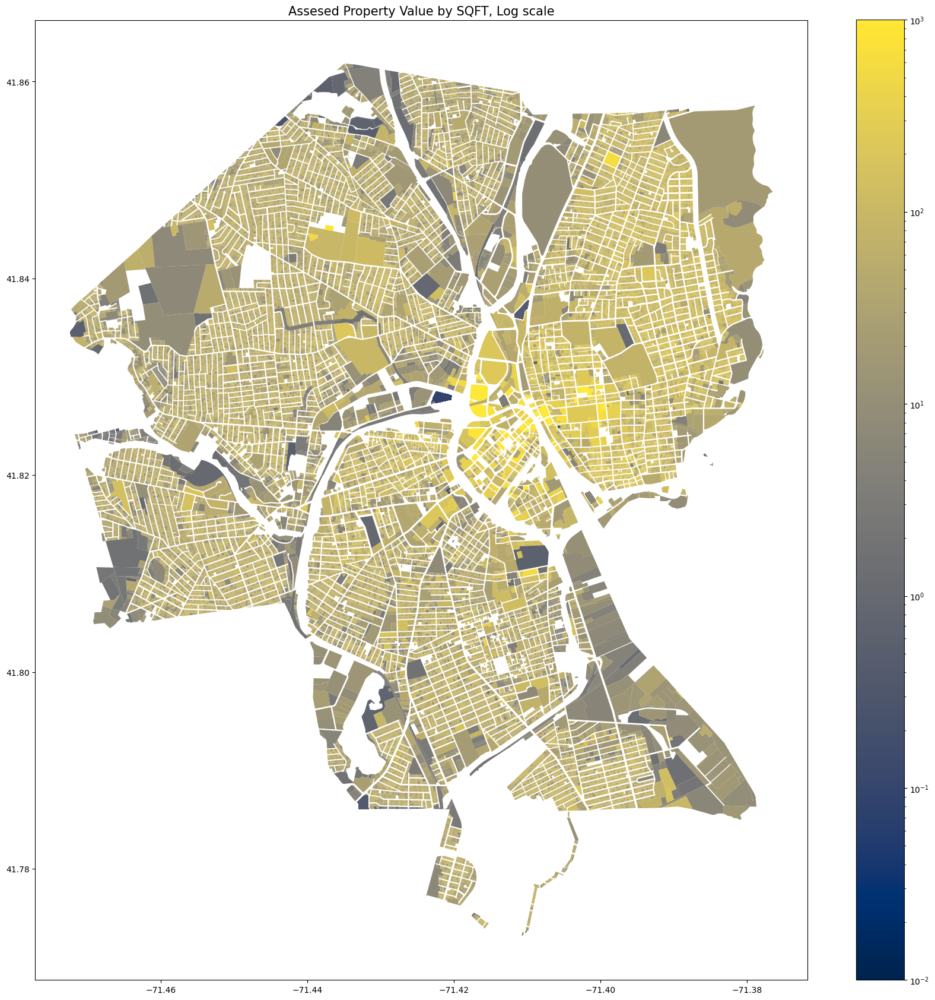

In [44]:
fig, ax = plt.subplots(figsize  = (21, 21))

main_geo_frame.plot(column = 'assesed_income_per_sqft',
                    cmap = 'cividis',
                    legend = True,
                    norm=mpl.colors.LogNorm(vmin = 0.01, vmax = 1000),
                    ax = ax)

ax.set_title("Assesed Property Value by SQFT, Log scale", fontsize=15)

Text(0.5, 1.0, 'All Properties, separated by state')

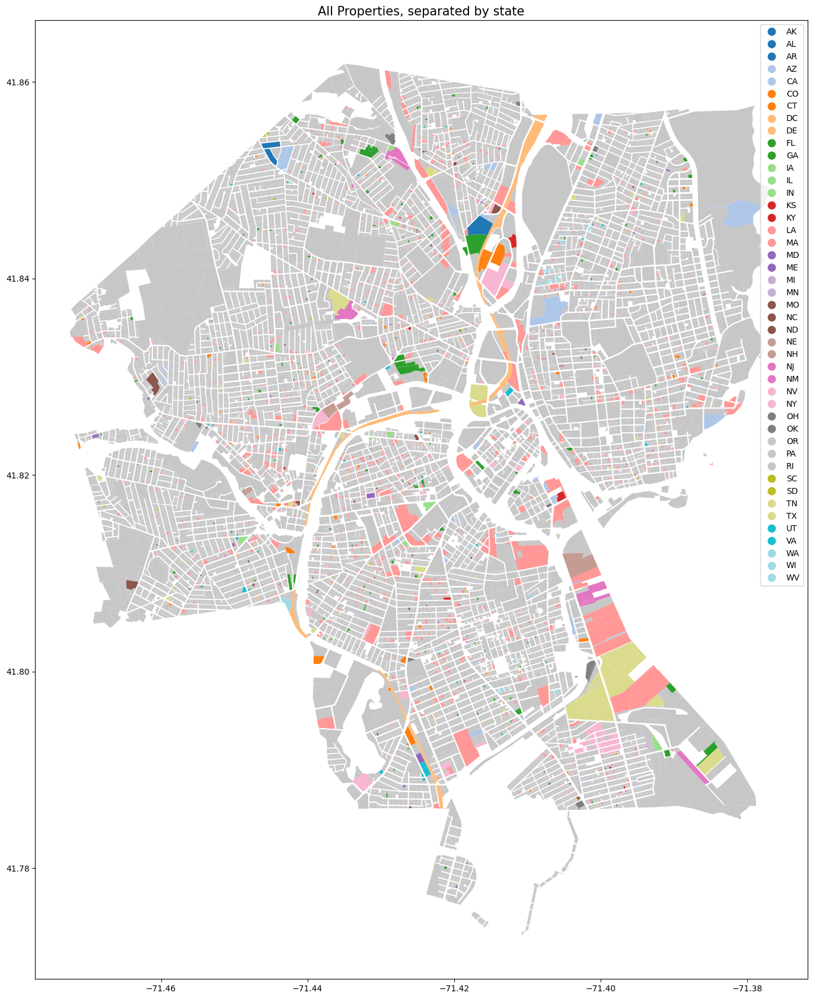

In [48]:
fig, ax = plt.subplots(figsize  = (21, 21))

#top_twenty_states = ['MA','NY','FL','CA','TX','CT','WA','PA','NJ','NH','VA','AZ','GA','OH','NC','MD','SC','IL','DC','OK']

main_geo_frame.plot(column = 'ownerstate',
                    cmap = 'tab20',
                    #categories = top_twenty_states,
                    legend = True,
                    categorical = True,
                    ax = ax)

ax.set_title("All Properties, separated by state", fontsize=15)




In [33]:
### This is an interactive map with almost every property. Too much, the rendering is a lil too slow

providence_prop_tax_map = tax_geo_frame.explore(
    column = 'income_per_sqft',
    #tooltip = ['Price', 'Zip Code', 'Listings in Zip'], ## this line will shorten up the tooltip
    norm=mpl.colors.LogNorm(vmin = 1.0, vmax = 100),
    style_kwds=dict(color="black"),
    legend = True,
    title = 'Providence Property Tax'
)

#providence_prop_tax_map
    

In [34]:
### making a map displaying 'polyowners', companies or people that own many properties.

properties_owned_mask = main_frame['property_owned_counts'] > 100

many_properties_frame = main_frame[properties_owned_mask]

#### Cast the prop frame to a GeoDataframe



many_properties_geo_frame = gpd.GeoDataFrame(many_properties_frame, geometry='geometry')

#many_properties_geo_frame['ownername'].unique()

owner_list = {'120.0':'hello','124.0':'its','172.0':'me','295.0':'the','361.0':'one'}

many_properties_geo_frame.explore(column = 'property_owned_counts',
                                  tooltip = {'TOTAL_TAXES', 'ownername', 'ownerstate', 'property_owned_counts', 'parc_add'},
                                 categorical = True,
                                 cmap = 'tab10')
                                 #categories = owner_list)
                                 #categories = many_properties_geo_frame['ownername'].unique())

In [35]:
####mapping all properrties owned outta state

out_of_state_mask = main_frame['ownerstate'] != 'RI'
tt = {'COMPANY','TOTAL_TAXES', 'ownername', 'ownerstate', 'OWNER_FORMATED_ADDRESS', 'parc_add'}

not_null_mask = main_frame['ownerstate'].notna()
#out_of_state_mask = main_frame['ownerstate'].notna() & main_frame['ownerstate'] != 'RI'

out_of_state_frame = main_frame[not_null_mask & out_of_state_mask]

out_of_state_geo_frame = gpd.GeoDataFrame(out_of_state_frame, geometry='geometry')

#out_of_state_frame

#main_frame['OWNER_STATE'].value_counts()
out_of_state_geo_frame.explore(column = 'realized_tax_pct', tooltip = tt)

In [49]:
tt = {'COMPANY','TOTAL_TAXES', 'ownername', 'ownerstate', 'OWNER_FORMATED_ADDRESS', 'parc_add'}
all_states = ['MA','NY','FL','CA','TX','CT','WA','PA','NJ','NH','VA','AZ','GA','OH','NC','MD','SC','IL','DC','OK',
          'UT','ME','NV','MO','CO','KY','DE','MN','NE','TN','AL','NM','MI','ND','KS','IN','OR','IA','WI','AK','SD','LA','AR','WV']

top_twenty_states = ['MA','NY','FL','CA','TX','CT','WA','PA','NJ','NH','VA','AZ','GA','OH','NC','MD','SC','IL','DC','OK']

out_of_state_property_map = out_of_state_geo_frame.explore(
    tooltip = tt,
    column='ownerstate', 
    categories= top_twenty_states,
    #cmap=['#1f78b4', '#e31a1c'],
    categorical=True,
    name='States'
)

In [50]:
out_of_state_property_map

In [51]:
##out_of_state_property_map.save('Out_of_state_ownership.html') ## This worked! run to save the map as an HTML page

In [37]:
bounds = main_geo_frame.total_bounds


bounds

array([-71.47264758,  41.77313891, -71.37653241,  41.8618308 ])

In [38]:
### gonna try to make an interactive map that has multiple 'layers'. Gonna start with the states. We'll see
### This might have to be done with python rather than folium. We'll see.



#statemap = folium.Map(location = [36.5, -106.5], zoom_start = 9.2, tiles = 'cartodbpositron', control_scale = True)
bounds = main_geo_frame.total_bounds


fig = Figure(width=800, height=400)

main_map = folium.Map(tiles = 'OpenStreetMap')
#main_map.fit_bounds([[bounds[1], bounds[0]], bounds[3],bounds[2]])
main_map.fit_bounds([-71.47264758,  41.77313891, -71.37653241,  41.8618308 ])

tt = {'COMPANY','TOTAL_TAXES', 'ownername', 'ownerstate', 'OWNER_FORMATED_ADDRESS', 'parc_add'}

#statemap = main_geo_frame[main_geo_frame['ownerstate'] == 'NY'].explore(tooltip = tt)
#MA_Map = main_geo_frame[main_geo_frame['ownerstate'] == 'MA'].explore(main_map = main_map, tooltip = tt)
#NY_Map = main_geo_frame[main_geo_frame['ownerstate'] == 'NY'].explore(main_map = main_map, tooltip = tt)

main_geo_frame[main_geo_frame['ownerstate'] == 'MA'].explore(main_map = main_map, tooltip = tt)
main_geo_frame[main_geo_frame['ownerstate'] == 'NY'].explore(main_map = main_map, tooltip = tt)

#folium.TileLayer('stamenwatercolor').add_to(statemap)

#ny_layer = folium.FeatureGroup(main_geo_frame[main_geo_frame['ownerstate'] == 'NY'].explore(tooltip = tt), name = 'NY owned')

#Mass_Layer = folium.FeatureGroup(name = 'Massachusetts Ownership')
#mainstem_layer = folium.FeatureGroup(show=True)
#usgs_layer = folium.FeatureGroup(name = 'USGS Gauges', show=True)

#out_of_state_geo_frame.add_to(statemap)
#ny_Layer.add_to(statemap)
#Mass_Layer.add_to(statemap)
#usgs_layer.add_to(statemap)
#mainstem_layer.add_to(statemap)
fig.add_child(main_map)


folium.LayerControl().add_to(main_map)
#folium.LayerControl().add_to(NY_Map)



main_map